# King's County Housing Data Project

## The Business Problem

Using a large data set of houses sold in the greater Seattle area, we are to predict the sale price of a house with a similar set of attributes by creating a multilinear regression model. 

### Features and Questions

* What are the most important variables in predicting sale price? 
* Is there a way we can reformat or combine data to improve the model?
* What type of statistical relationships will be most beneficial to our model?

In this exploration notebook, I performed several statistical tests, created data visualizations to interpret data, and performed numerous A/B tests of models with different features in order to create the best model for predicting housing prices.

### Importing libraries and data

In [1]:
# Data organization
import pandas as pd
import numpy as np

# Visualizations
import matplotlib.pyplot as plt 
import seaborn as sns

# Data pre-preprocessing, modeling and evaluation
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.dummy import DummyRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import PolynomialFeatures
from sklearn.feature_selection import f_classif
from sklearn.decomposition import PCA
from scipy import stats

# Custom function modules
import model
import data_clean as dc

In [2]:
# Load in data
data = pd.read_csv('../data/kc_house_data_train.csv')

## Exploratory Data Analysis

In [3]:
data.head()

,Unnamed: 0,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,0,2591820310,20141006T000000,365000.0,4,2.25,2070,8893,2.0,0,...,8,2070,0,1986,0,98058,47.4388,-122.162,2390,7700
1,1,7974200820,20140821T000000,865000.0,5,3.00,2900,6730,1.0,0,...,8,1830,1070,1977,0,98115,47.6784,-122.285,2370,6283
2,2,7701450110,20140815T000000,1038000.0,4,2.50,3770,10893,2.0,0,...,11,3770,0,1997,0,98006,47.5646,-122.129,3710,9685
3,3,9522300010,20150331T000000,1490000.0,3,3.50,4560,14608,2.0,0,...,12,4560,0,1990,0,98034,47.6995,-122.228,4050,14226
4,4,9510861140,20140714T000000,711000.0,3,2.50,2550,5376,2.0,0,...,9,2550,0,2004,0,98052,47.6647,-122.083,2250,4050


### Dropping the extra index column

In [4]:
data = data.drop(columns = 'Unnamed: 0')

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17290 entries, 0 to 17289
Data columns (total 21 columns):
id               17290 non-null int64
date             17290 non-null object
price            17290 non-null float64
bedrooms         17290 non-null int64
bathrooms        17290 non-null float64
sqft_living      17290 non-null int64
sqft_lot         17290 non-null int64
floors           17290 non-null float64
waterfront       17290 non-null int64
view             17290 non-null int64
condition        17290 non-null int64
grade            17290 non-null int64
sqft_above       17290 non-null int64
sqft_basement    17290 non-null int64
yr_built         17290 non-null int64
yr_renovated     17290 non-null int64
zipcode          17290 non-null int64
lat              17290 non-null float64
long             17290 non-null float64
sqft_living15    17290 non-null int64
sqft_lot15       17290 non-null int64
dtypes: float64(5), int64(15), object(1)
memory usage: 2.8+ MB


### Checking the data and fixing outliers

* Bathrooms and bedrooms both have some anamolous stuff- I converted all the zeros to ones and changed the bedroom counts above 10 to 10
* Grade has very few rows with values less than 4- I changed them to 4 in order to avoid asymmetrical dummy categories between my train and test sets

In [6]:
np.where(data.bathrooms < 1)

#checking for 0 values in the bathroom column- there are a lot

(array([  350,   483,   543,  1120,  1122,  1310,  1379,  1381,  1438,
         1487,  1540,  1622,  1696,  2329,  2430,  2692,  3032,  3123,
         3748,  3851,  4201,  4622,  4921,  5072,  5301,  5424,  5489,
         5612,  6966,  7093,  7161,  7263,  7309,  8000,  8224,  8710,
         9060,  9193,  9286,  9469,  9516,  9796, 10067, 10086, 10559,
        11214, 11560, 11716, 11753, 12578, 12662, 12674, 12982, 13508,
        14509, 14987, 15465, 15703, 16126, 16260, 16398, 16779, 17163]),)

In [7]:
data['bathrooms'] = data.bathrooms.apply(lambda x: 1 if x < 1 else x)

#a simple function to change all 0s to 1s in the bathrooms column

In [8]:
data['bedrooms'] = data.bedrooms.apply(lambda x: 3 if x == 33 else x)

data['bedrooms'] = data.bedrooms.apply(lambda x: 1 if x < 1 else x)


#dealing with outliers in the bedroom column- 1 house listed 33 bedrooms, several have 0

In [9]:
data['grade'] = data.grade.apply(lambda x: 4 if x < 4 else x)

#changing the minimum grade to 4- there are a few outlier numbers which created an asymmetrical number of dummy columns after my train/test split

The below cell is commented out to test and improve accuracy on the holdout set. 

In [10]:
# data['adjprice'] = dc.price_adjust(data.price)

#changing outliers in the price column to the upper and lower 2.5 percentile

### Creating histograms of all variables 
Examining which are continuous and categorical

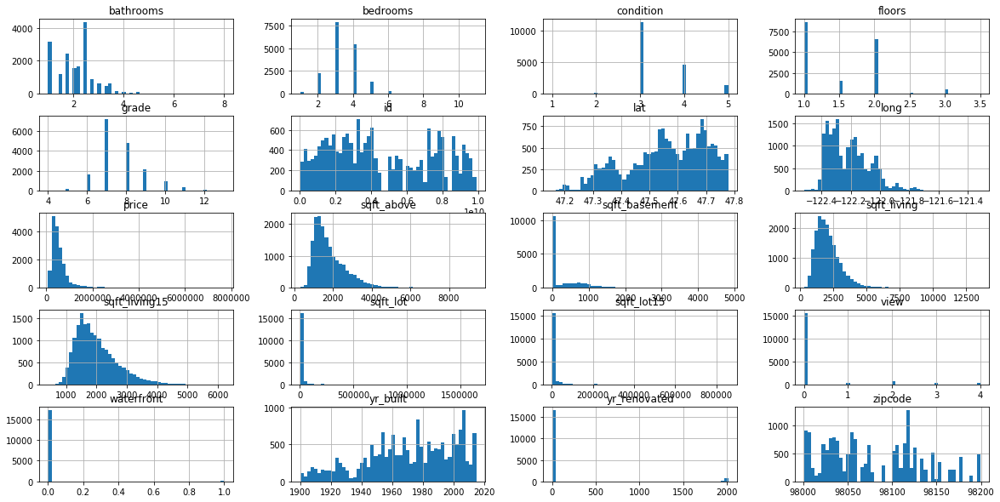

In [10]:
data.hist(bins = 50, figsize = (20,10))
plt.show()

Continuous Variables - price, sqft_above, sqft_basement, sqft_living, sqft_living15, sqft_lot, yr_built

Categoricals - bathrooms, bedrooms, condition, floors, grade, view, waterfront

### ANOVA tests

Testing all the categorical variables for F scores and P values

In [11]:
categoricals = ['bathrooms', 'bedrooms', 'condition', 'floors', 'grade', 'view', 'waterfront']

F, pval = f_classif(data[categoricals], data.price)

f_Scores = {x:y for (x,y) in zip(categoricals, F)}

p_val = {x:y for (x,y) in zip(categoricals, pval)}

print('F Scores: ', f_Scores)
print('P Values: ', p_val)

F Scores:  {'bathrooms': 3.387249399713691, 'bedrooms': 1.7480366418342326, 'condition': 1.0664789450030623, 'floors': 1.5508717885159158, 'grade': 6.5652356252711925, 'view': 2.39131804414836, 'waterfront': 2.969767626813982}
P Values:  {'bathrooms': 0.0, 'bedrooms': 4.452711485445367e-108, 'condition': 0.007478899144421187, 'floors': 3.197728804728122e-66, 'grade': 0.0, 'view': 2.771157263324339e-273, 'waterfront': 0.0}


All seem to be statistically significant as shown by the low p values, but the variation is high in grade, view and waterfront.

### Graphing relationships between my target variable and unmodified features

I made scatterplots, a heatmap and generated a correlation table to examine my features and see what interacted best with price and had acceptable levels of collinearity before selecting the features for my first model.

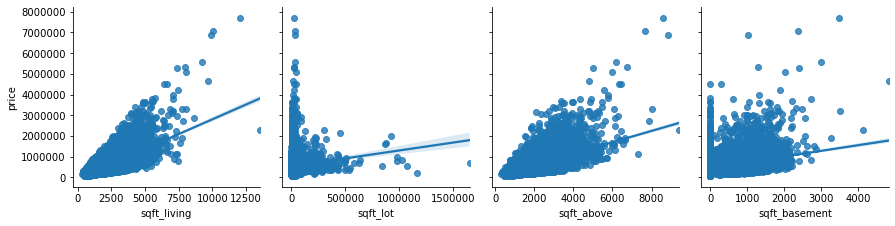

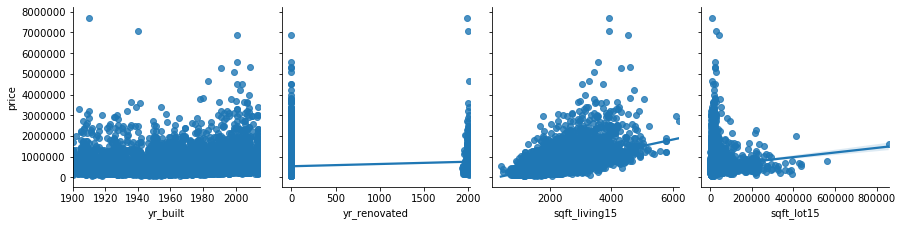

In [12]:
continuous = ['sqft_living', 'sqft_lot', 'sqft_above', 'sqft_basement',            'yr_built', 'yr_renovated', 'sqft_living15', 'sqft_lot15']

n = 4
row_groups= [continuous[i:i+n] for i in range(0, len(continuous), n) ]

for i in row_groups:
    pp = sns.pairplot(data=data, y_vars=['price'],x_vars=i, kind="reg", height=3)

I can see from the scatterplots that there are positive correlations between price and sqft_living, sqft_above and sqft_basement. The other square foot measurements are weaker. The renovated and built categories will need to be manipulated to make them more useful. 

### T-Tests for the Continuous Variables

Next I checked to verify my observations above.

In [14]:
for i in continuous:
    print(i, stats.ttest_ind(data[i], data.price))

data[continuous].corrwith(data.price)

sqft_living Ttest_indResult(statistic=-189.72706600897698, pvalue=0.0)
sqft_lot Ttest_indResult(statistic=-183.91460662804914, pvalue=0.0)
sqft_above Ttest_indResult(statistic=-189.83007872116943, pvalue=0.0)
sqft_basement Ttest_indResult(statistic=-190.35774235632712, pvalue=0.0)
yr_built Ttest_indResult(statistic=-189.76662297207906, pvalue=0.0)
yr_renovated Ttest_indResult(statistic=-190.43115340044702, pvalue=0.0)
sqft_living15 Ttest_indResult(statistic=-189.7602479400402, pvalue=0.0)
sqft_lot15 Ttest_indResult(statistic=-185.43391609935793, pvalue=0.0)


sqft_living      0.703540
sqft_lot         0.086803
sqft_above       0.607760
sqft_basement    0.323312
yr_built         0.056450
yr_renovated     0.117770
sqft_living15    0.585567
sqft_lot15       0.081423
dtype: float64

Again, all significant, although the strength of the correlations vary wildly and the low p values may be a result of the large data set size. The square foot metrics are my strongest predictors so far, but I expect a lot of collinearity from them.

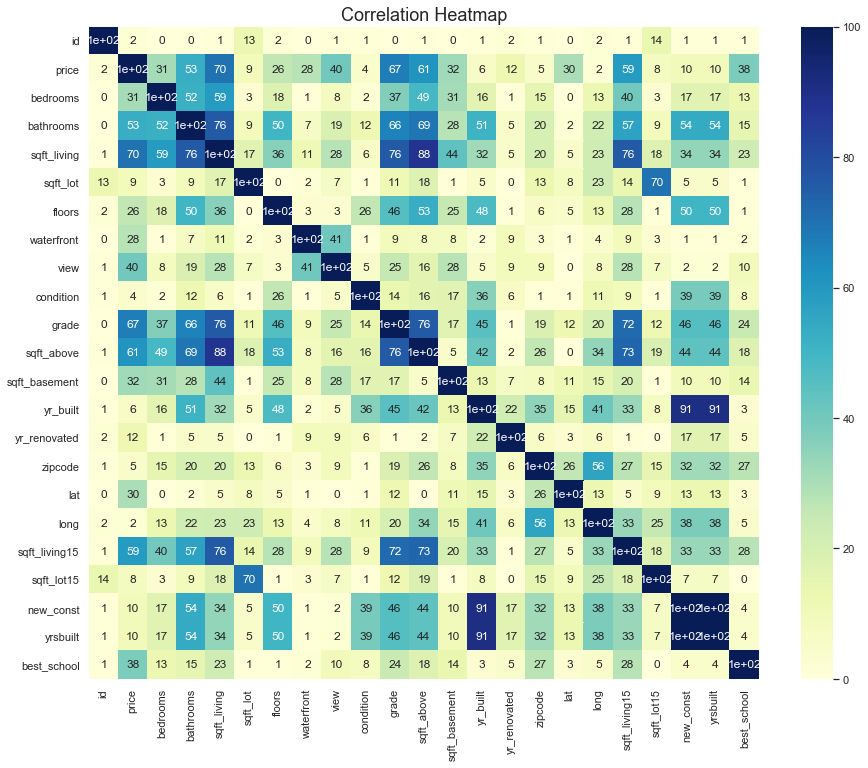

In [22]:
sns.set(rc={'figure.figsize': (15,12)})
sns.heatmap((abs(round(data.corr(), 2)*100)), robust = True, annot= True, cmap = 'YlGnBu')
plt.title('Correlation Heatmap', fontsize = 18);

Finally, I made a correlation heatmap to examine the correlation. I used the absolute value to make the data more descriptive.

## Feature Engineering

### Combining yr_built and yr_renovated into a new variable

In [13]:
data['new_const'] = dc.new_construction(data.yr_renovated, data.yr_built)

#choosing a date value from the two columns- the renovation year if the home has been renovated, the construction year if not

In [14]:
data['yrsbuilt'] = 2015 - data.new_const

#subtracting the last construction year from 2015- the last year in the dataset

### Working with Zipcodes

* Googled best school districts in Seattle by Zipcode
* Created a function to make a new dummy column indicated whether a house is located in one of the best school districts

In [15]:
best_school_zip = [98004, 98006, 98040, 98039]

data['best_school'] = dc.best_schools(data.zipcode, best_school_zip)

### Performing a train/test split stratified by zipcodes

In [16]:
train_set, test_set = train_test_split(data, test_size=0.25, random_state=99, stratify=data.zipcode)

In [17]:
train_set.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12967 entries, 7018 to 3888
Data columns (total 24 columns):
id               12967 non-null int64
date             12967 non-null object
price            12967 non-null float64
bedrooms         12967 non-null int64
bathrooms        12967 non-null float64
sqft_living      12967 non-null int64
sqft_lot         12967 non-null int64
floors           12967 non-null float64
waterfront       12967 non-null int64
view             12967 non-null int64
condition        12967 non-null int64
grade            12967 non-null int64
sqft_above       12967 non-null int64
sqft_basement    12967 non-null int64
yr_built         12967 non-null int64
yr_renovated     12967 non-null int64
zipcode          12967 non-null int64
lat              12967 non-null float64
long             12967 non-null float64
sqft_living15    12967 non-null int64
sqft_lot15       12967 non-null int64
new_const        12967 non-null int64
yrsbuilt         12967 non-null int64
best

In [18]:
data.zipcode.value_counts()/len(data)

98052    0.027415
98115    0.026894
98103    0.026663
98038    0.026316
98117    0.025275
           ...   
98102    0.004627
98010    0.004280
98024    0.003759
98148    0.002487
98039    0.002429
Name: zipcode, Length: 70, dtype: float64

In [19]:
train_set.zipcode.value_counts()/len(train_set)

#checking my zipcode distribution against the full dataset

98052    0.027377
98115    0.026914
98103    0.026683
98038    0.026298
98117    0.025295
           ...   
98102    0.004627
98010    0.004319
98024    0.003779
98039    0.002468
98148    0.002468
Name: zipcode, Length: 70, dtype: float64

The features with the highest correlation to price are the group of square footage measurements and categorical values like bathrooms, grade, and view. The zipcode feature is misinterpretted as a numeric value here, and we'll need to split it into dummies to properly test it. Interestingly, latitude has a pretty decent correlation with price, which I'm guessing means that in our target area, houses are generally more expensive the further north you go. 

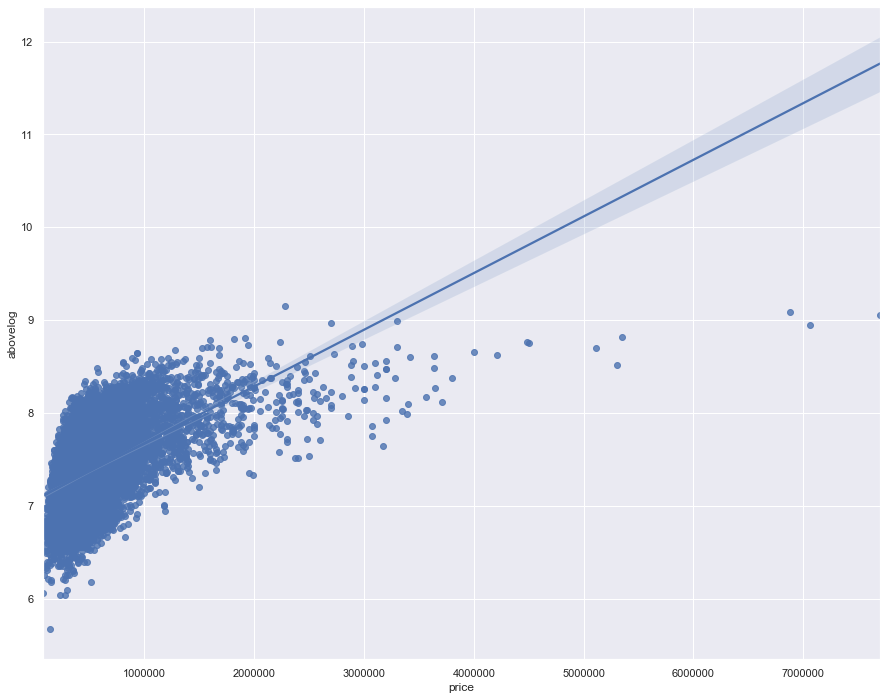

In [23]:
#Log generation
train_set['bathroomlog'] = np.log(train_set.bathrooms)
test_set['bathroomlog'] = np.log(test_set.bathrooms)
train_set['lotlog'] = np.log(train_set.sqft_lot)
test_set['lotlog'] = np.log(test_set.sqft_lot)
train_set['abovelog'] = np.log(train_set.sqft_above)
test_set['abovelog'] = np.log(test_set.sqft_above)
sns.regplot(train_set.price, train_set.abovelog)

### Creating dummy columns for each of our categorical variables
* Wrote a function to streamline the conversion for the test set
* Generated separate dummy DataFrames to keep the main DataFrame manageable and keep feature additions modular
* Selected the 98024 zip code (Snoqualmie, quite a bit east of Seattle) to drop
* Dropped the least populated categories in view, condition and grade

In [24]:
#using the function to generate dummy columns for five variables

zip_dummies = dc.dummy_list(train_set.zipcode, 'zip', 98024)

#for zipcode, this should be more descriptive as the model otherwise interprets them as numbers


grade_dummies = dc.dummy_list(train_set.grade, 'grade', 4)
con_dummies = dc.dummy_list(train_set.condition, 'cond', 1)
view_dummies = dc.dummy_list(train_set.view, 'view', 1)
month_dummies = dc.month_dummies(train_set.date)

#breaking the sales up by month should explain some of the variation in volume and subsequent demand-based inflation

## Creating the Models

### Setting up a dummy regressor to inspect the base score and RMSE

In [26]:
y_train = train_set.price

#setting the dependant variable- this remains constant throughout the tests

x_train = pd.DataFrame(train_set[['sqft_living', 'bedrooms', 'bathrooms', 'yr_built', 'grade', 'view']])

#creating a dataframe with the first test set of features

dummy = DummyRegressor()

#instantiating the dummy regressor to get the control group numbers

dummy.fit(x_train, y_train)

dummy.score(x_train, y_train)

0.0

In [27]:
y_pred = dummy.predict(x_train)

#using the dummy regressor to generate the RMSE if none of the predictors are used in the model

dummy_rmse = mean_squared_error(y_train, y_pred)

dummy_rmse**.5

376408.8360546109

After running the dummy regressor on my cleaned data, the control number is 285,954, meaning the average error from the correct predicted price is USD 285,954

### Running a preliminary test with the same features

In [28]:
lr = LinearRegression()

#instantiating linear regression

lr.fit(x_train, y_train)

#fitting the model to the selected features and dependant variable

y_pred = lr.predict(x_train)

#generating predictions and R squared score

lr.score(x_train, y_train)

0.6342567372502853

In [29]:
lr_rsme = mean_squared_error(y_train, y_pred)

#generating the root mean squared error for our first model

lr_rsme**.5

227639.6856434216

### The first model

* R Squared is .67 - not bad but could definitely improve. 
* RSME is 227,639. Around 150,000 better than the dummy regressor, but my goal is to get as close as I can to 100k.

### Testing the model with dummies added

In [30]:
TestVar2 = pd.concat([train_set[['sqft_living', 'bedrooms', 'bathrooms', 'yr_built']], zip_dummies, con_dummies, grade_dummies, view_dummies, month_dummies], axis = 1)

#same as above here - setting a group of features, fitting to the model and making predictions

#I've removed the categoricals I replaced with dummy columns

model.train_model(TestVar2, y_train)

R Squared:0.822273484002146 RSME:158685.0172822492


### The second model
* With dummies added the R squared has jumped 20 points
* RSME is down another 60,000. Well on the way to my goal.

### Testing with a feature that combines bedrooms and bathrooms

In [31]:
train_set['bedbath'] = train_set['bedrooms'] * train_set['bathrooms']

#multiplying the bedroom and bathroom columns to create a new feature

In [32]:
TestVar3 = pd.concat([train_set[['sqft_living', 'bedbath', 'yr_built', 'abovelog']], zip_dummies,con_dummies, grade_dummies, view_dummies, month_dummies], axis = 1)

model.train_model(TestVar3, y_train)

R Squared:0.8213317905294109 RSME:159104.8624095122


### The third model
* This model performed slightly better than the preceding one. I decide to keep the bedbath index.

### Square foot measurements
* Since the square footage seemed to be the best overall indicator of price, I combined the non-basement square footage and living room size and scaled against the max of those products

In [33]:
train_set['sqftagg'] = train_set.sqft_living * train_set.sqft_living15 
train_set.sqftagg = train_set.sqftagg/train_set.sqftagg.max()

# the aggregated square foot feature combines the living room with the avg square footage of the nearest 15 homes

In [34]:
TestVar4 = pd.concat([train_set[['sqftagg', 'bedbath', 'yr_built', 'abovelog']], zip_dummies, con_dummies, grade_dummies, view_dummies], axis = 1)

model.train_model(TestVar4, y_train)

R Squared:0.8166293884662662 RSME:161185.0196236424


### The fourth test
This time, slightly worse than without the engineered features

<br><br>From here I decided to look at my residuals and see if there was a pattern.

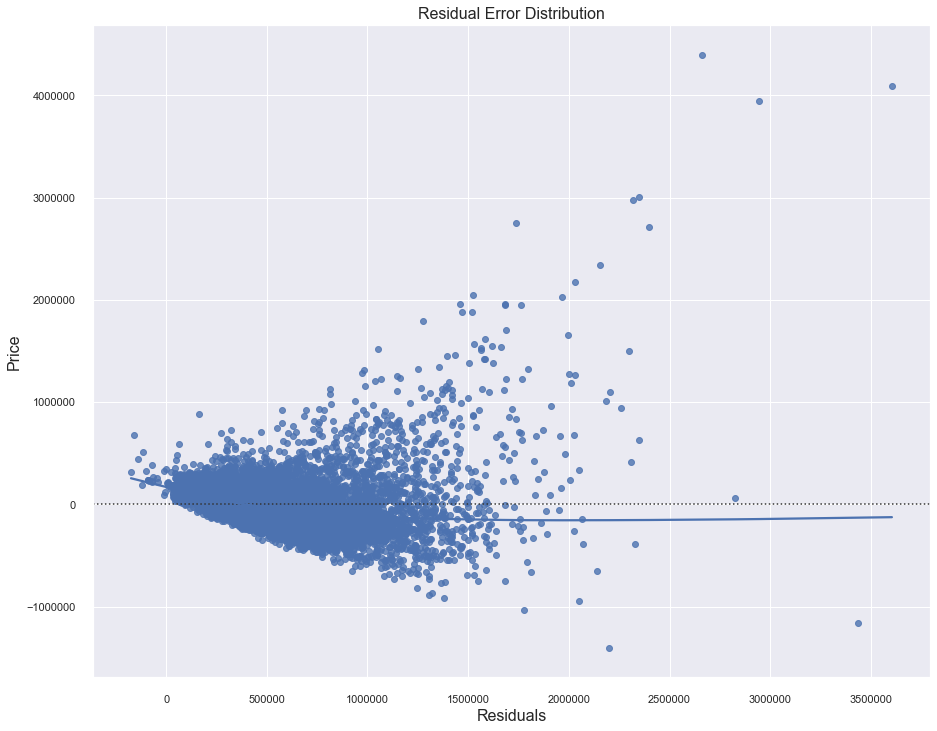

In [35]:
sns.residplot(y_pred, train_set.price, lowess=True)
plt.xlabel('Residuals', fontsize = 16)
plt.ylabel('Price', fontsize = 16)
plt.title('Residual Error Distribution', fontsize = 16)
plt.tick_params(size = 14)

The expanding shape indicated I should definitely try polynomial functions.

Below represents my best model so far. I decided to try exponentiating the whole thing. 

In [36]:
TestVar5 = pd.concat([train_set[['sqft_living', 'bedrooms', 'lotlog', 'best_school']], zip_dummies, con_dummies, grade_dummies, view_dummies, month_dummies], axis = 1)

model.train_model(TestVar5, y_train)

#here I attempted a log function on the predictor variable, which had less than satisfactory results
model.train_model_log(TestVar5, np.log(y_train))

#So far this is among my best RMSEs, so I decided to use the Polynomial Function on this model

R Squared:0.822333986622036 RSME:158658.00477805934
R Squared:0.874663082492212 RSME:660575.4586402061


In [37]:
X_train_poly = model.polynomialize(TestVar5, 2)

#this function runs the Polynomial Function on every feature in my DataFrame

In [38]:
lr.fit(X_train_poly, y_train)
y_pred = lr.predict(X_train_poly)
r2 = lr.score(X_train_poly, y_train)
rsme = mean_squared_error(y_train, y_pred)
print('R Squared:' + str(r2), 'RSME:' + str(rsme**.5))

R Squared:0.928016438617612 RSME:100989.55872367113


Definitely looks too good to be true. Next I run my model on the test set.

In [40]:
#removing outliers from the test set's price columns with my adjust function

Y_test = test_set.price

#running my functions to create dummy columns and log functions for the features in my test set

testzip_dummies = dc.dummy_list(test_set.zipcode, 'zip', 98024)
testgrade_dummies = dc.dummy_list(test_set.grade, 'grade', 4)
testcond_dummies = dc.dummy_list(test_set.condition, 'cond', 1)
testview_dummies = dc.dummy_list(test_set.view, 'view', 1)
testmonth_dummies = dc.month_dummies(test_set.date)

#creating a DataFrame of my model features from the test set

X_test = pd.concat([test_set[['sqft_living', 'bedrooms', 'lotlog', 'best_school']], testzip_dummies, testcond_dummies, testgrade_dummies, testview_dummies, testmonth_dummies], axis = 1)

#running the polynomial function on everything

X_test_poly = model.polynomialize(X_test, 2)

In [41]:
y_test_pred = lr.predict(X_test_poly)
r2 = lr.score(X_test_poly, Y_test)
rsme = mean_squared_error(Y_test, y_test_pred)
print('R Squared:' + str(r2), 'RSME:' + str((rsme**.5)))

R Squared:0.7860289066389041 RSME:168293.64353065606


As predicted, the numbers were too good to be true. My model is finally overfit. Time to scale back my features and make more deliberate choices on what to use the polynomial function on.

In [42]:
poly_columns = pd.concat([train_set[['sqft_living', 'bedrooms', 'bathrooms', 'best_school', 'abovelog', 'lotlog']], con_dummies, view_dummies, month_dummies], axis = 1)

#selecting a new set of features to polynomialize

X_train_poly = model.polynomialize(poly_columns, 2)

X_train_agg = pd.concat([zip_dummies, grade_dummies], axis = 1)

#combining the dummy categories I removed

X_train_agg.reset_index(drop = True, inplace = True)

#resetting the index so they can be combined

X_train_agg = pd.concat([X_train_agg, X_train_poly], axis = 1)

In [43]:
lr.fit(X_train_agg, y_train)
y_pred = lr.predict(X_train_agg)
r2 = lr.score(X_train_agg, y_train)
rsme = mean_squared_error(y_train, y_pred)
print('R Squared:' + str(r2), 'RSME:' + str(rsme**.5))

#this looks a bit more realistic

R Squared:0.8634172126885622 RSME:139109.82217007148


In [44]:
X_test_columns = pd.concat([test_set[['sqft_living', 'bedrooms', 'bathrooms', 'best_school', 'abovelog', 'lotlog']], testcond_dummies, testview_dummies, testmonth_dummies], axis = 1)

#reproducing the train model above

X_test_poly = model.polynomialize(X_test_columns, 2)

X_test_agg = pd.concat([testzip_dummies,  testgrade_dummies], axis = 1)

X_test_agg.reset_index(drop = True, inplace = True)

X_test_agg = pd.concat([X_test_agg, X_test_poly], axis = 1)

In [45]:
y_test_pred = lr.predict(X_test_agg)
r2 = lr.score(X_test_agg, Y_test)
rsme = mean_squared_error(Y_test, y_test_pred)
print('R Squared:' + str(r2), 'RSME:' + str((rsme**.5)))

#not perfect, but a lot better!

R Squared:0.8307101628527219 RSME:149694.41713823448


In [49]:
pca = PCA()

pca.fit_transform(X_train_poly)

array([[ 3.36160051e+06, -4.75719967e+03,  2.24652066e+02, ...,
         0.00000000e+00,  0.00000000e+00,  6.36653101e-08],
       [-1.40324890e+06, -1.71666100e+03, -1.78584977e+03, ...,
         9.03116669e-11, -3.34612424e-10,  1.54355985e-11],
       [ 2.52266684e+06, -3.46390594e+03, -7.32930052e+01, ...,
        -3.52758764e-10,  3.51001478e-10,  1.44355016e-10],
       ...,
       [-2.74085783e+06,  1.05846030e+03, -2.47471041e+02, ...,
        -3.43563982e-11,  2.86363674e-11,  6.11933539e-12],
       [ 3.49677695e+06, -6.99259479e+03, -2.15098726e+03, ...,
        -4.59757057e-12, -1.41114525e-11,  7.12026487e-13],
       [ 2.52266480e+06, -2.41719311e+03, -5.74111925e+02, ...,
         3.19289101e-12,  5.13629556e-12,  6.11588579e-12]])

This model fits the test set far better and it's pretty close to my goal. I decided to check the residuals again and see if there's any difference.

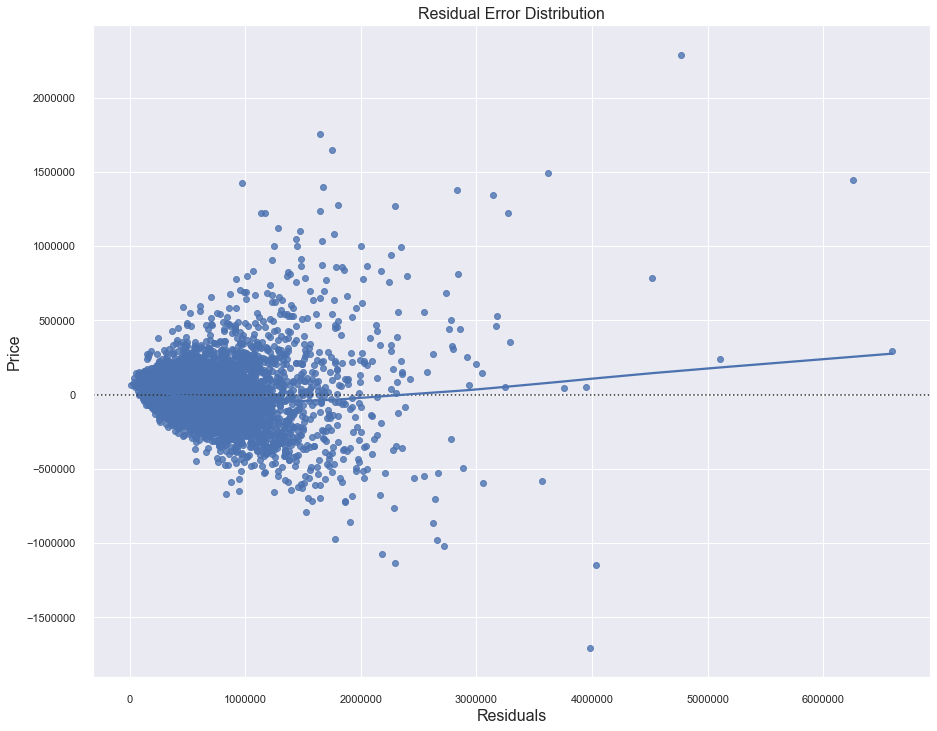

In [46]:
sns.residplot(y_pred, train_set.price, lowess=True)
plt.xlabel('Residuals', fontsize = 16)
plt.ylabel('Price', fontsize = 16)
plt.title('Residual Error Distribution', fontsize = 16)
plt.tick_params(size = 14)

Success! I feel like I could probably get a little closer with another day and a log function, but I'm definitely on the right track.<br><br>
Now to plot my predictions against the two Y variables and look at the distribution.

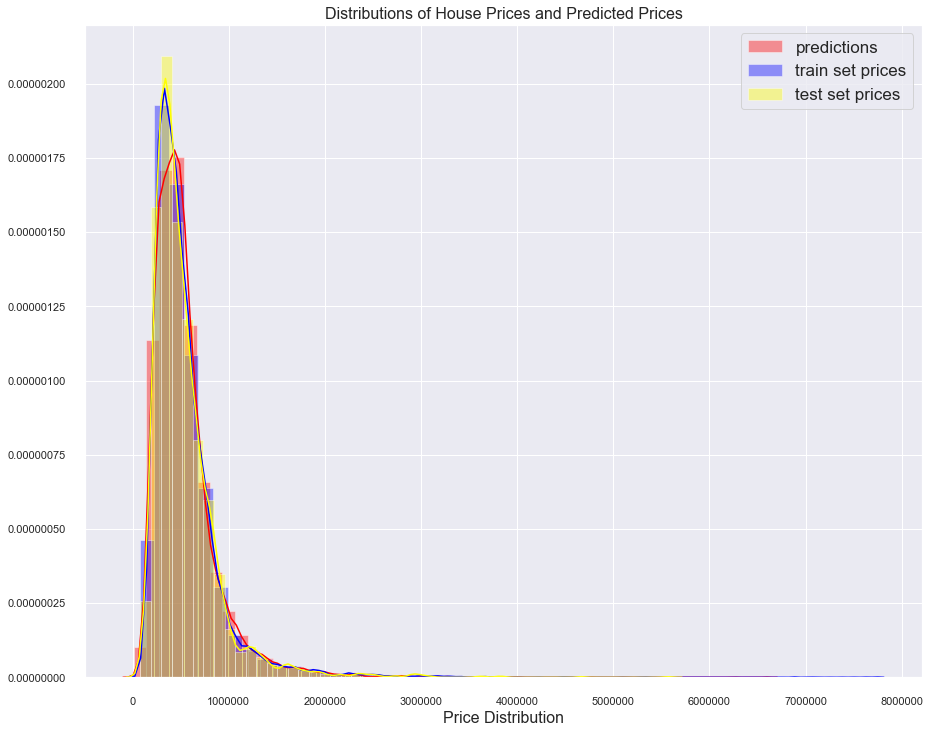

In [47]:
sns.distplot(y_pred, color = 'red', label = 'predictions')
sns.distplot(y_train, color = 'blue', label = 'train set prices')
sns.distplot(Y_test, color = 'yellow', label = 'test set prices')
plt.title('Distributions of House Prices and Predicted Prices', fontsize = 16)
plt.tick_params(size = 16)
plt.xlabel('Price Distribution', fontsize = 16)
plt.legend(prop = {'size' : 17})

There's obviously a little more ground that I could gain by either dropping or redistributing those high outlier numbers, but I still think I'm on target.

### Testing my features with KBest

In [46]:
from sklearn.feature_selection import SelectKBest, f_regression,mutual_info_regression

selector = SelectKBest(f_regression, k = 200)

best_X_train = pd.concat([train_set[['bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors','sqft_above', 'sqft_basement', 'yr_built',
       'sqft_living15', 'sqft_lot15', 'new_const', 'yrsbuilt', 'best_school']], zip_dummies, con_dummies, grade_dummies, view_dummies, month_dummies], axis = 1)

best_X_test = pd.concat([test_set[['bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors','sqft_above', 'sqft_basement', 'yr_built',
       'sqft_living15', 'sqft_lot15', 'new_const', 'yrsbuilt', 'best_school']], testzip_dummies, testcond_dummies, testgrade_dummies, testview_dummies, testmonth_dummies], axis = 1)

X_train_poly = model.polynomialize(best_X_train, 2)
X_test_poly = model.polynomialize(best_X_test, 2)

selector.fit(X_train_poly, y_train)

SelectKBest(k=200, score_func=<function f_regression at 0x7fd074caf158>)

In [47]:
selected_columns = X_train_poly.columns[selector.get_support()]
removed_columns = X_train_poly.columns[~selector.get_support()]

In [48]:
KBest_Xtrain = pd.concat([X_train_poly[selected_columns]])

model.train_model(KBest_Xtrain, y_train)

R Squared:0.7540971575873965 RSME:141800.66756589728


K Best suggested a substantially worse model than the one I created. I tried several differnt numbers of features and the RSME went up as I reduced them.

In [48]:
from sklearn.linear_model import Lasso
from sklearn import metrics

lasso = Lasso(alpha=0.1, normalize=False)

lasso.fit(X_train_agg, y_train)

y_train_pred = lasso.predict(X_train_agg)
y_pred = lasso.predict(X_test_agg)

train_rmse_lasso01 = metrics.mean_absolute_error(y_train, y_train_pred)
test_rmse_lasso01 = np.sqrt(metrics.mean_squared_error(Y_test, y_test_pred))
print('Training Error: '+ str(train_rmse_lasso01) )
print('Testing Error: '+ str(test_rmse_lasso01) )


Training Error: 83089.6172091924
Testing Error: 149694.41713823448


## Conclusion

Though I didn't quite reach my goal, I did have a bit of success and learned a lot in the process. 
<br><br>
The model reached an average error of USD107k, which was pretty good. My biggest takeaway from this process was that the modeling process mattered far less than the data cleaning, and every small step I took to fix outliers created a major difference in my R squared and RMSE. 
<br><br>
In the end, the best predictors were the obvious one- square footage, location, and some of the overall grading. None of the fancy features I tried to engineer had major impacts, though some did help the model a bit. 